 ## Cloud Cover Semantic Segmentation
### Final project: Baseline

Project Team: <br>
Kurt Eulau <br>
Steve Hewitt <br>
Tom Welsh <br>


Citations: <br>
 - TBD

### Objectives: 
 - TBD

---
### Step 1: Import packages
---

In [1]:
%%capture
!pip install pandas_path pytorch_lightning cloudpathlib loguru typer wandb# added wandb
%load_ext autoreload
%autoreload 2

In [2]:
# Apparently loading packages according to above may be problematic, reloading them with an alternative method
# https://jakevdp.github.io/blog/2017/12/05/installing-python-packages-from-jupyter/
import sys
!{sys.executable} -m pip install pandas_path pytorch_lightning cloudpathlib loguru typer wandb

In [3]:
# Installing wandb can be difficult, you may need to 'pip install wandb' from the terminal 
%%capture
!pip install wandb -qqq

In [4]:
import shutil
import csv
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from pandas_path import path  # noqa
from pathlib import Path
from PIL import Image
import pytorch_lightning as pl
import torch
import rasterio
import pyproj
import rioxarray
import xrspatial.multispectral as ms
from my_preprocessing_20220322 import *
import segmentation_models_pytorch as smp
from typing import Optional, List
import warnings

In [5]:
import wandb

#### Step 1A (Optional): Log training to wandb.ai

In [6]:
from pytorch_lightning.loggers import WandbLogger
from pytorch_lightning import Trainer

wandb_logger = WandbLogger(project="baseline-model-v1", entity="w207-clouds")

---
### Step 2a: Define working directories and global variables
---

In [7]:
DATA_DIR = Path("/driven-data/cloud-cover")
TRAIN_FEATURES = DATA_DIR / "train_features"
TRAIN_LABELS = DATA_DIR / "train_labels"

assert TRAIN_FEATURES.exists()

In [8]:
BANDS = ["B02", "B03", "B04", "B08"]

In [50]:
train_meta = pd.read_csv(DATA_DIR / "train_metadata.csv")
display(train_meta)

,chip_id,location,datetime,cloudpath
0,adwp,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adwp
1,adwu,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adwu
2,adwz,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adwz
3,adxp,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adxp
4,aeaj,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/aeaj
...,...,...,...,...
11743,zxwv,Launceston,2020-09-06T00:08:20Z,az://./train_features/zxwv
11744,zxxo,Launceston,2020-09-06T00:08:20Z,az://./train_features/zxxo
11745,zxym,Launceston,2020-09-06T00:08:20Z,az://./train_features/zxym
11746,zxza,Launceston,2020-09-06T00:08:20Z,az://./train_features/zxza


---
## Classes and Functions
---

---
### Classes
---

In [10]:
# create benchmark_src folder
submission_dir = Path("benchmark_src")
if submission_dir.exists():
    shutil.rmtree(submission_dir)

submission_dir.mkdir(parents=True)

In [11]:
%%file {submission_dir}/cloud_dataset.py
import numpy as np
import pandas as pd
import rasterio
import torch
from typing import Optional, List


class CloudDataset(torch.utils.data.Dataset):
    """Reads in images, transforms pixel values, and serves a
    dictionary containing chip ids, image tensors, and
    label masks (where available).
    """

    def __init__(
        self,
        x_paths: pd.DataFrame, # : syntax specifies datatype for each parameter for CloudDataset objects
        bands: List[str],
        y_paths: Optional[pd.DataFrame] = None,
        transforms: Optional[list] = None,
    ):
        """
        Instantiate the CloudDataset class.

        Args:
            x_paths (pd.DataFrame): a dataframe with a row for each chip. There must be a column for chip_id,
                and a column with the path to the TIF for each of bands
            bands (list[str]): list of the bands included in the data
            y_paths (pd.DataFrame, optional): a dataframe with a for each chip and columns for chip_id
                and the path to the label TIF with ground truth cloud cover
            transforms (list, optional): list of transforms to apply to the feature data (eg augmentations)
        """
        self.data = x_paths
        self.label = y_paths
        self.transforms = transforms
        self.bands = bands

    def __len__(self):
        return len(self.data)
    
    # Similar to pop, helps iterate through dataset
    def __getitem__(self, idx: int):
        # Loads an n-channel image from a chip-level dataframe
        img = self.data.loc[idx]
        band_arrs = []
        for band in self.bands:
            with rasterio.open(img[f"{band}_path"]) as b:
                band_arr = b.read(1).astype("float32")
            band_arrs.append(band_arr)
        x_arr = np.stack(band_arrs, axis=-1) # 3-dimensional array

        # Apply data augmentations, if provided
        if self.transforms:
            x_arr = self.transforms(image=x_arr)["image"]
        x_arr = np.transpose(x_arr, [2, 0, 1]) # re-orders array to match expected format needed for model

        # Prepare dictionary for item
        item = {"chip_id": img.chip_id, "chip": x_arr}

        # Load label if available
        if self.label is not None:
            label_path = self.label.loc[idx].label_path
            with rasterio.open(label_path) as lp:
                y_arr = lp.read(1).astype("float32")
            # Apply same data augmentations to the label
            if self.transforms:
                y_arr = self.transforms(image=y_arr)["image"]
            item["label"] = y_arr

        return item

Writing benchmark_src/cloud_dataset.py


In [12]:
%%file {submission_dir}/cloud_model.py
from typing import Optional, List

import pandas as pd
import pytorch_lightning as pl
import segmentation_models_pytorch as smp
import torch

try:
    from cloud_dataset import CloudDataset
    from losses import intersection_over_union
except ImportError:
    from benchmark_src.cloud_dataset import CloudDataset
    from benchmark_src.losses import intersection_over_union


class CloudModel(pl.LightningModule):
    def __init__(
        self,
        bands: List[str],
        x_train: Optional[pd.DataFrame] = None,
        y_train: Optional[pd.DataFrame] = None,
        x_val: Optional[pd.DataFrame] = None,
        y_val: Optional[pd.DataFrame] = None,
        hparams: dict = {},
    ):
        """
        Instantiate the CloudModel class based on the pl.LightningModule
        (https://pytorch-lightning.readthedocs.io/en/latest/common/lightning_module.html).

        Args:
            bands (list[str]): Names of the bands provided for each chip
            x_train (pd.DataFrame, optional): a dataframe of the training features with a row for each chip.
                There must be a column for chip_id, and a column with the path to the TIF for each of bands.
                Required for model training
            y_train (pd.DataFrame, optional): a dataframe of the training labels with a for each chip
                and columns for chip_id and the path to the label TIF with ground truth cloud cover.
                Required for model training
            x_val (pd.DataFrame, optional): a dataframe of the validation features with a row for each chip.
                There must be a column for chip_id, and a column with the path to the TIF for each of bands.
                Required for model training
            y_val (pd.DataFrame, optional): a dataframe of the validation labels with a for each chip
                and columns for chip_id and the path to the label TIF with ground truth cloud cover.
                Required for model training
            hparams (dict, optional): Dictionary of additional modeling parameters.
        """
        super().__init__()
        self.hparams.update(hparams)
        self.save_hyperparameters()

        # required
        self.bands = bands

        # optional modeling params
        self.backbone = self.hparams.get("backbone", "resnet34")
        self.weights = self.hparams.get("weights", "imagenet")
        self.learning_rate = self.hparams.get("lr", 1e-3)
        self.patience = self.hparams.get("patience", 4)
        self.num_workers = self.hparams.get("num_workers", 2)
        self.batch_size = self.hparams.get("batch_size", 32)
        self.gpu = self.hparams.get("gpu", False)
        self.transform = None

        # Instantiate datasets, model, and trainer params if provided
        self.train_dataset = CloudDataset(
            x_paths=x_train,
            bands=self.bands,
            y_paths=y_train,
            transforms=self.transform,
        )
        self.val_dataset = CloudDataset(
            x_paths=x_val,
            bands=self.bands,
            y_paths=y_val,
            transforms=None,
        )
        self.model = self._prepare_model()

    ## Required LightningModule methods ##

    def forward(self, image: torch.Tensor):
        # Forward pass
        return self.model(image)

    def training_step(self, batch: dict, batch_idx: int):
        """
        Training step.

        Args:
            batch (dict): dictionary of items from CloudDataset of the form
                {'chip_id': list[str], 'chip': list[torch.Tensor], 'label': list[torch.Tensor]}
            batch_idx (int): batch number
        """
        if self.train_dataset.data is None:
            raise ValueError(
                "x_train and y_train must be specified when CloudModel is instantiated to run training"
            )

        # Switch on training mode
        self.model.train()
        torch.set_grad_enabled(True)

        # Load images and labels
        x = batch["chip"]
        y = batch["label"].long()
        if self.gpu:
            x, y = x.cuda(non_blocking=True), y.cuda(non_blocking=True)

        # Forward pass
        preds = self.forward(x)

        # Log batch loss
        loss = torch.nn.CrossEntropyLoss(reduction="none")(preds, y).mean()
        self.log(
            "loss",
            loss,
            on_step=True,
            on_epoch=True,
            prog_bar=True,
            logger=True,
        )
        return loss

    def validation_step(self, batch: dict, batch_idx: int):
        """
        Validation step.

        Args:
            batch (dict): dictionary of items from CloudDataset of the form
                {'chip_id': list[str], 'chip': list[torch.Tensor], 'label': list[torch.Tensor]}
            batch_idx (int): batch number
        """
        if self.val_dataset.data is None:
            raise ValueError(
                "x_val and y_val must be specified when CloudModel is instantiated to run validation"
            )

        # Switch on validation mode
        self.model.eval()
        torch.set_grad_enabled(False)

        # Load images and labels
        x = batch["chip"]
        y = batch["label"].long()
        if self.gpu:
            x, y = x.cuda(non_blocking=True), y.cuda(non_blocking=True)

        # Forward pass & softmax
        preds = self.forward(x)
        preds = torch.softmax(preds, dim=1)[:, 1]
        preds = (preds > 0.5) * 1  # convert to int

        # Log batch IOU
        batch_iou = intersection_over_union(preds, y)
        self.log(
            "iou", batch_iou, on_step=True, on_epoch=True, prog_bar=True, logger=True
        )
        return batch_iou

    def train_dataloader(self):
        # DataLoader class for training
        return torch.utils.data.DataLoader(
            self.train_dataset,
            batch_size=self.batch_size,
            num_workers=self.num_workers,
            shuffle=True,
            pin_memory=True,
        )

    def val_dataloader(self):
        # DataLoader class for validation
        return torch.utils.data.DataLoader(
            self.val_dataset,
            batch_size=self.batch_size,
            num_workers=0,
            shuffle=False,
            pin_memory=True,
        )

    def configure_optimizers(self):
        opt = torch.optim.Adam(self.model.parameters(), lr=self.learning_rate)
        sch = torch.optim.lr_scheduler.CosineAnnealingLR(opt, T_max=10)
        return [opt], [sch]

    ## Convenience Methods ##

    def _prepare_model(self):
        # Instantiate U-Net model
        unet_model = smp.Unet(
            encoder_name=self.backbone,
            encoder_weights=self.weights,
            in_channels=4,
            classes=2,
        )
        if self.gpu:
            unet_model.cuda()

        return unet_model

Writing benchmark_src/cloud_model.py


---
### Functions
---

In [13]:
def add_paths(df, feature_dir, label_dir=None, bands=BANDS):
    """
    Given dataframe with a column for chip_id, returns a dataframe with a column
    added indicating the path to each band's TIF image as "{band}_path", eg "B02_path".
    A column is also added to the dataframe with paths to the label TIF, if the
    path to the labels directory is provided.
    """
    for band in bands:
        df[f"{band}_path"] = feature_dir / df["chip_id"] / f"{band}.tif"
        # make sure a random sample of paths exist
        assert df.sample(n=40, random_state=5)[f"{band}_path"].path.exists().all()
    if label_dir is not None:
        df["label_path"] = label_dir / (df["chip_id"] + ".tif")
        # make sure a random sample of paths exist
        assert df.sample(n=40, random_state=5)["label_path"].path.exists().all()

    return df

In [14]:
%%file {submission_dir}/losses.py
import numpy as np

# Loss function
def intersection_over_union(pred, true):
    """
    Calculates intersection and union for a batch of images.

    Args:
        pred (torch.Tensor): a tensor of predictions
        true (torc.Tensor): a tensor of labels

    Returns:
        intersection (int): total intersection of pixels
        union (int): total union of pixels
    """
    valid_pixel_mask = true.ne(255)  # valid pixel mask
    true = true.masked_select(valid_pixel_mask).to("cpu")
    pred = pred.masked_select(valid_pixel_mask).to("cpu")

    # Intersection and union totals
    intersection = np.logical_and(true, pred)
    union = np.logical_or(true, pred)
    return intersection.sum() / union.sum()

Writing benchmark_src/losses.py


In [119]:
# Import the cloud model we just saved.
from benchmark_src.cloud_model import CloudModel

# Pre-processing

## Clean the data

Upon visual inspection, we discovered that some chips whose labels indicated "no cloud" actually had clearly defineable clouds in them, and some chips whose labels indicated "100% cloud" were actually not completely covered by clouds.

While it was not possible to inspect every pixel of every chip in the dataset, we felt that our model would be improved by removing the most egregious errors from the total universe of chips under consideration before they were split into training, validation, and test sets.

In [51]:
train_meta = add_paths(train_meta, TRAIN_FEATURES, TRAIN_LABELS)
train_meta.shape  # this is the original size of our universe of chips

(11748, 9)

In [16]:
# separate features from labels
# feature_cols = ["chip_id"] + [f"{band}_path" for band in BANDS]
# full_set, empty_val_set, empty_test_set = train_val_test_split(train_meta, column='location', pct_train=1.0, pct_val=0.0, pct_test=0.0, random_state=42)
# full_set.shape

# full_set_x=full_set[feature_cols].copy()
# full_set_y=full_set[["chip_id", "label_path"]].copy()

In [35]:
# Create a full set of our train_meta for use later
full_set = train_meta.copy()
full_set_x=full_set[feature_cols].copy()
full_set_y=full_set[["chip_id", "label_path"]].copy()

In [36]:
print(full_set.shape)

(11748, 9)


## Display a particular chip by name (useful for debugging)

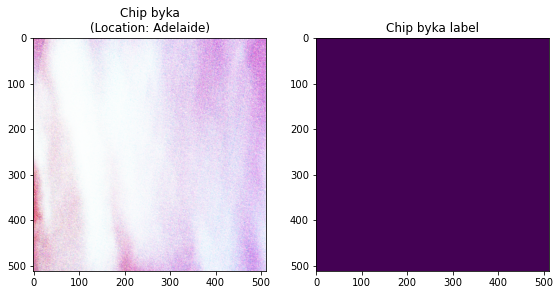

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
Number of cloud pixels in label: 0
Proportion of cloud pixels in label: 0.0


In [18]:
# This function allows you to display a chip by name
display_true_color_label_pixel_count('byka', full_set)

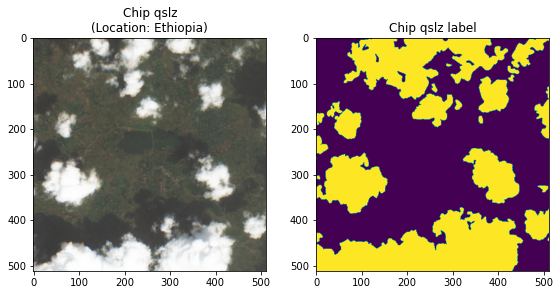

[[0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 [0 0 0 ... 1 1 1]
 ...
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]
 [1 1 1 ... 0 0 0]]
Number of cloud pixels in label: 105556
Proportion of cloud pixels in label: 0.403


In [19]:
display_true_color_label_pixel_count('qslz', full_set)

## Clean out mislabelled chips

Our focus was on removing chips that indicated that incorrectly labelled "no cloud" or "fully cloud":
-Some chips were labelled as having 0 cloud pixels when the clearly had clouds upon visual inspection
-Some chips were labelled as every pixel was a cloud, even though the chip did not have full cloud cover

In [20]:
# This cell takes about 10-12 minutes to run--leave this cell and the ones below commented out unless you want to
# recount the list of chips whose cells are either 0 clouds or all clouds. Since these outputs are written to csv files
# below, they do not need to be rerun each time, the information can be pulled directly from the csv files.

# list_of_no_cloud_chips = []
# list_of_all_cloud_chips = []
# for index, row in full_set_y.iterrows():
#     index_id = index
#     chip_id = row[0]
#     label_path = row[1]
#     with Image.open(label_path) as im:
#         label_arr = np.array(im)
#         ones_count = np.count_nonzero(label_arr)
#         if ones_count == 0:
#             list_of_no_cloud_chips.append(chip_id)
#         if ones_count == 512*512:
#             list_of_all_cloud_chips.append(chip_id)

In [21]:
# Prints a list of chips labelled "NO CLOUD"
# print('list of chips labelled "NO CLOUD:"')
# print(list_of_no_cloud_chips)

# Prints a list of chips labelled "ALL CLOUD"
# print('\nlist of chips labelled "ALL CLOUD:"')
# print(list_of_all_cloud_chips)

list of chips labelled "NO CLOUD:"
['aisf', 'ctbf', 'csrr', 'cutk', 'cwee', 'ahfi', 'cucj', 'cvnj', 'cudp', 'ctzz', 'afqf', 'cuyt', 'alfq', 'akkb', 'ankq', 'amgj', 'alht', 'apiw', 'asaq', 'cmyk', 'cpjd', 'cpay', 'coig', 'auza', 'crjn', 'crjl', 'cpuz', 'cngf', 'cqac', 'cpod', 'cndo', 'crxa', 'cnwy', 'bhfg', 'bgjq', 'bguw', 'bjri', 'bhzs', 'bitg', 'bkdx', 'blce', 'bkuh', 'blge', 'bgml', 'buih', 'btgh', 'brvo', 'bsak', 'buwi', 'buqh', 'brzu', 'budp', 'bvbo', 'bsar', 'bryx', 'bunu', 'btge', 'bsci', 'btlq', 'bvbi', 'brnl', 'bsoo', 'bttp', 'butb', 'buzr', 'bric', 'brng', 'buty', 'btfb', 'btqi', 'butu', 'btbm', 'btdl', 'bsls', 'bsux', 'brxp', 'buid', 'bupp', 'btna', 'burx', 'brvx', 'bugz', 'bxoq', 'bvkx', 'bvne', 'bvsz', 'bxpb', 'bxvp', 'bwio', 'byoj', 'bwdd', 'byka', 'byfn', 'bwao', 'bxxh', 'bwlz', 'bwjs', 'byfc', 'bvfg', 'bxyx', 'bxvv', 'bydd', 'bylc', 'cdug', 'ckhd', 'cive', 'cipz', 'cmbv', 'cmdp', 'clok', 'cmmt', 'cjqh', 'cjks', 'cmfr', 'cmhl', 'ckim', 'cjoy', 'cjnb', 'ckgv', 'cjvz', 'clp

## Write lists of 'no cloud' and 'all cloud' chips to csv files (leave this section commented out after data cleaned)

In [22]:
# Store chips with no clouds in 'no_cloud_chips.csv'

# list_of_no_cloud_chips_df = pd.DataFrame(list_of_no_cloud_chips, columns=['chip_id'])
# list_of_no_cloud_chips_df.to_csv('no_cloud_chips.csv', index=False, header=False)
# with open('no_cloud_chips.csv', 'w+', newline='') as file:     
#     write = csv.writer(file, delimiter='\n', lineterminator='\n') 
#     write.writerow(list_of_no_cloud_chips) 


# Store chips with no clouds in 'no_cloud_chips.csv'

# list_of_all_cloud_chips_df = pd.DataFrame(list_of_all_cloud_chips, columns=['chip_id'])
# list_of_all_cloud_chips_df.to_csv('all_cloud_chips.csv', index=False, header=False)
# with open('all_cloud_chips.csv', 'w+', newline='') as file:     
#     write = csv.writer(file, delimiter='\n', lineterminator='\n') 
#     write.writerow(list_of_all_cloud_chips) 

## Visually inspect chips whose labels have 0 cloud pixels and manually record mislabelled chips in a separate csv file (leave this section commented out after data cleaned)

In [34]:
# Select chips from csv files for display
with open('no_cloud_chips.csv', newline='') as f:
    reader = csv.reader(f)
    no_cloud_list = list(reader)

# flatten list
flat_no_cloud_list = [item for sublist in no_cloud_list for item in sublist]
print(f"There are {len(flat_no_cloud_list)} chips out of the original {full_set.shape[0]} whose labels indicate 0 cloud pixels.") 
# print(flat_no_cloud_list)   # Uncomment this line to see a listing of chips whose labels have 0 cloud pixels

There are 787 chips out of the original 11748 whose labels indicate 0 cloud pixels.


In [27]:
# subset a dataframe of just those chips
inspect_no_clouds_set = full_set.loc[full_set['chip_id'].isin(flat_no_cloud_list)]

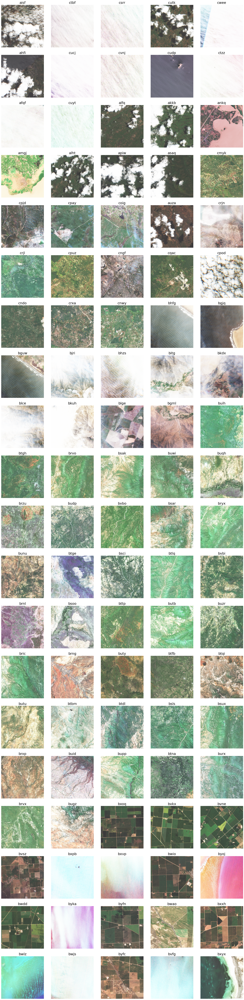

In [74]:
# visually inspect these chips in groups of 100, and record (in a spreadsheet) which images clearly have clouds--
# these are mislabelled and may throw off our models (it may take a minute or two to display)

inspect_no_clouds_subset = inspect_no_clouds_set[0:100]  # adjust this slice index to display [100:200], [200:300], etc.

fig, axs = plt.subplots(20, 5, figsize=(20,80))
fig.tight_layout()
counter = 0
for i in range(20):
    for j in range(5):
        example_chip = inspect_no_clouds_subset.iloc[counter]
        im = true_color_img(example_chip.chip_id)
        axs[i,j].imshow(im)
        axs[i,j].tick_params(left=False, labelleft=False, right=False)
        axs[i,j].patch.set_visible(False)
        axs[i,j].set_title(example_chip.chip_id, fontsize=20)
        axs[i,j].axis('off')
        counter += 1
plt.show()

## Visually inspect chips whose labels have 100% (512 x 512 = 262,144) cloud pixels and manually record mislabelled chips in a separate csv file 

In [61]:
# Select chips from csv files for display
with open('all_cloud_chips.csv', newline='') as f:
    reader = csv.reader(f)
    all_cloud_list = list(reader)

# flatten list
flat_all_cloud_list = [item for sublist in all_cloud_list for item in sublist]
print(f"There are {len(flat_all_cloud_list)} chips out of the original {full_set.shape[0]} whose labels indicate every pixel is a cloud.") 
# print(flat_no_cloud_list)   # Uncomment this line to see a listing of chips whose labels have 0 cloud pixels

There are 2998 chips out of the original 11748 whose labels indicate every pixel is a cloud.


In [62]:
# subset a dataframe of just those chips
inspect_all_clouds_set = full_set.loc[full_set['chip_id'].isin(flat_all_cloud_list)]

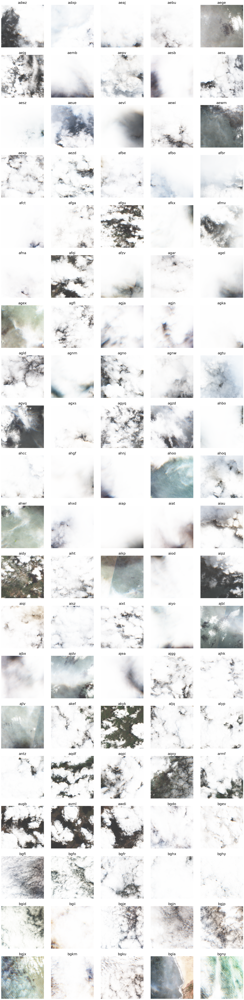

In [108]:
# visually inspect these chips in groups of 100, and record (in a spreadsheet) which images clearly have clouds--
# these are mislabelled and may throw off our models

inspect_all_clouds_subset = inspect_all_clouds_set[0:100]  # adjust this slice index to see [100:200], [200:300], etc.

fig, axs = plt.subplots(20, 5, figsize=(20,80))
fig.tight_layout()
counter = 0
for i in range(20):
    for j in range(5):
        example_chip = inspect_all_clouds_subset.iloc[counter]
        im = true_color_img(example_chip.chip_id)
        axs[i,j].imshow(im)
        axs[i,j].tick_params(left=False, labelleft=False, right=False)
        axs[i,j].patch.set_visible(False)
        axs[i,j].set_title(example_chip.chip_id, fontsize=20)
        axs[i,j].axis('off')
        counter += 1
plt.show()

## Visually inspect the chips to be rejected
Note: indexes in the rejection_list_set[0:205] were rejected because they were labelled "no clouds" when they had clouds.  Higher indexes were rejected because they were labelled "100% clouds" when clearly not every pixel was a cloud.

In [110]:
# Select chips from csv files for display
with open('incorrectly_labeled_chips.csv', newline='') as f:
    reader = csv.reader(f)
    all_cloud_list = list(reader)

# flatten list
rejection_list = [item for sublist in all_cloud_list for item in sublist]
print(f"There are {len(rejection_list)} chips out of the original {full_set.shape[0]} whose labels indicate every pixel is a cloud.") 
# print(flat_no_cloud_list)   # Uncomment this line to see a listing of chips whose labels have 0 cloud pixels

There are 787 chips out of the original 11748 whose labels indicate every pixel is a cloud.


In [111]:
# subset a dataframe of just those chips
rejection_list_set = full_set.loc[full_set['chip_id'].isin(rejection_list)]

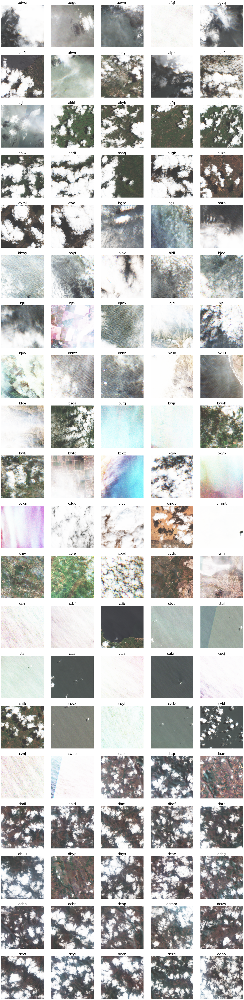

In [112]:
# visually inspect these chips in groups of 100, and record (in a spreadsheet) which images clearly have clouds--
# these are mislabelled and may throw off our models

rejection_list_subset = rejection_list_set[0:100]  # adjust this slice index to see [100:200], [200:300], etc.

fig, axs = plt.subplots(20, 5, figsize=(20,80))
fig.tight_layout()
counter = 0
for i in range(20):
    for j in range(5):
        example_chip = rejection_list_subset.iloc[counter]
        im = true_color_img(example_chip.chip_id)
        axs[i,j].imshow(im)
        axs[i,j].tick_params(left=False, labelleft=False, right=False)
        axs[i,j].patch.set_visible(False)
        axs[i,j].set_title(example_chip.chip_id, fontsize=20)
        axs[i,j].axis('off')
        counter += 1
plt.show()

## Remove the mislabeled chips from the model

In [113]:
full_set_cleaned = remove_chips(full_set, 'incorrectly_labeled_chips.csv') # train_meta renamed to this smaller group
display(full_set_cleaned)
print(f"A total of {full_set.shape[0]-full_set_cleaned.shape[0]} chips that were deemed mislabled have been removed the original {full_set.shape[0]} chips.") 

,chip_id,location,datetime,cloudpath,B02_path,B03_path,B04_path,B08_path,label_path
0,adwp,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adwp,/driven-data/cloud-cover/train_features/adwp/B...,/driven-data/cloud-cover/train_features/adwp/B...,/driven-data/cloud-cover/train_features/adwp/B...,/driven-data/cloud-cover/train_features/adwp/B...,/driven-data/cloud-cover/train_labels/adwp.tif
1,adwu,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adwu,/driven-data/cloud-cover/train_features/adwu/B...,/driven-data/cloud-cover/train_features/adwu/B...,/driven-data/cloud-cover/train_features/adwu/B...,/driven-data/cloud-cover/train_features/adwu/B...,/driven-data/cloud-cover/train_labels/adwu.tif
3,adxp,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/adxp,/driven-data/cloud-cover/train_features/adxp/B...,/driven-data/cloud-cover/train_features/adxp/B...,/driven-data/cloud-cover/train_features/adxp/B...,/driven-data/cloud-cover/train_features/adxp/B...,/driven-data/cloud-cover/train_labels/adxp.tif
4,aeaj,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/aeaj,/driven-data/cloud-cover/train_features/aeaj/B...,/driven-data/cloud-cover/train_features/aeaj/B...,/driven-data/cloud-cover/train_features/aeaj/B...,/driven-data/cloud-cover/train_features/aeaj/B...,/driven-data/cloud-cover/train_labels/aeaj.tif
5,aeap,Chifunfu,2020-04-29T08:20:47Z,az://./train_features/aeap,/driven-data/cloud-cover/train_features/aeap/B...,/driven-data/cloud-cover/train_features/aeap/B...,/driven-data/cloud-cover/train_features/aeap/B...,/driven-data/cloud-cover/train_features/aeap/B...,/driven-data/cloud-cover/train_labels/aeap.tif
...,...,...,...,...,...,...,...,...,...
11741,zxuw,Launceston,2020-09-06T00:08:20Z,az://./train_features/zxuw,/driven-data/cloud-cover/train_features/zxuw/B...,/driven-data/cloud-cover/train_features/zxuw/B...,/driven-data/cloud-cover/train_features/zxuw/B...,/driven-data/cloud-cover/train_features/zxuw/B...,/driven-data/cloud-cover/train_labels/zxuw.tif
11742,zxvi,Launceston,2020-09-06T00:08:20Z,az://./train_features/zxvi,/driven-data/cloud-cover/train_features/zxvi/B...,/driven-data/cloud-cover/train_features/zxvi/B...,/driven-data/cloud-cover/train_features/zxvi/B...,/driven-data/cloud-cover/train_features/zxvi/B...,/driven-data/cloud-cover/train_labels/zxvi.tif
11744,zxxo,Launceston,2020-09-06T00:08:20Z,az://./train_features/zxxo,/driven-data/cloud-cover/train_features/zxxo/B...,/driven-data/cloud-cover/train_features/zxxo/B...,/driven-data/cloud-cover/train_features/zxxo/B...,/driven-data/cloud-cover/train_features/zxxo/B...,/driven-data/cloud-cover/train_labels/zxxo.tif
11745,zxym,Launceston,2020-09-06T00:08:20Z,az://./train_features/zxym,/driven-data/cloud-cover/train_features/zxym/B...,/driven-data/cloud-cover/train_features/zxym/B...,/driven-data/cloud-cover/train_features/zxym/B...,/driven-data/cloud-cover/train_features/zxym/B...,/driven-data/cloud-cover/train_labels/zxym.tif


A total of 762 chips that were deemed mislabled have been removed the original 11748 chips.


<a id='split-data'></a>

## Split the data

To train our model, we want to separate the data into a "training", "validation", and "test" set. That way we'll have a portion of labelled data that was not used in model training, which can give us a more accurate sense of how our model will perform on the competition test data. Remember, none of the test set locations are in competition training data, so your model's will performance will ultimately be measured on unseen locations.

For each geography, we split our chips randomly into 60% training, 20% validation and 20% test.

In [114]:
train, val, test = train_val_test_split(full_set_cleaned, column='location', pct_train=0.6, pct_val=0.2, pct_test=0.2, random_state=42)   

In [115]:
full_set_cleaned.shape, train.shape, val.shape, test.shape

((10986, 9), (6556, 9), (2198, 9), (2232, 9))

In [116]:
# separate features from labels
feature_cols = ["chip_id"] + [f"{band}_path" for band in BANDS]

train_x = train[feature_cols].copy()
train_y = train[["chip_id", "label_path"]].copy()

val_x = val[feature_cols].copy()
val_y = val[["chip_id", "label_path"]].copy()

test_x = test[feature_cols].copy()
test_y = test[["chip_id", "label_path"]].copy()

---
### Step 6: Model Training
---

In [117]:
warnings.filterwarnings("ignore")

In [120]:
## Set up pytorch_lightning.Trainer object
cloud_model = CloudModel(
    bands=BANDS,
    x_train=train_x,
    y_train=train_y,
    x_val=val_x,
    y_val=val_y,
    hparams={"num_workers": 7, "batch_size": 16},
)
checkpoint_callback = pl.callbacks.ModelCheckpoint(
    monitor="iou_epoch", mode="max", verbose=True
)
early_stopping_callback = pl.callbacks.early_stopping.EarlyStopping(
    monitor="iou_epoch",
    patience=(cloud_model.patience * 3),
    mode="max",
    verbose=True,
)

trainer = pl.Trainer(
    gpus=1,
    fast_dev_run=False,
    callbacks=[checkpoint_callback, early_stopping_callback],
    logger = wandb_logger
)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


In [ ]:
# Fit the model
trainer.fit(model = cloud_model)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: w207-clouds (use `wandb login --relogin` to force relogin)


wandb: WARNING Serializing object of type DataFrame that is 2917564 bytes
wandb: WARNING Serializing object of type DataFrame that is 1029436 bytes
wandb: WARNING Serializing object of type DataFrame that is 978254 bytes
wandb: WARNING Serializing object of type DataFrame that is 345230 bytes

  | Name  | Type | Params
-------------------------------
0 | model | Unet | 24.4 M
-------------------------------
24.4 M    Trainable params
0         Non-trainable params
24.4 M    Total params
97.759    Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

In [ ]:
# save the model
submission_assets_dir = submission_dir / "assets"
submission_assets_dir.mkdir(parents=True, exist_ok=True)

model_weight_path = submission_assets_dir / "cloud_model.pt"
torch.save(cloud_model.state_dict(), model_weight_path)

---
### Step 7: Model Evaluation
---

In [ ]:
%%file benchmark_src/main.py
import os
from pathlib import Path
from typing import List

from loguru import logger
import pandas as pd
from PIL import Image
import torch
import typer

try:
    from cloud_dataset import CloudDataset
    from cloud_model import CloudModel
except ImportError:
    from benchmark_src.cloud_dataset import CloudDataset
    from benchmark_src.cloud_model import CloudModel


ROOT_DIRECTORY = Path("/codeexecution")
PREDICTIONS_DIRECTORY = ROOT_DIRECTORY / "predictions"
ASSETS_DIRECTORY = ROOT_DIRECTORY / "assets"
DATA_DIRECTORY = ROOT_DIRECTORY / "data"
INPUT_IMAGES_DIRECTORY = DATA_DIRECTORY / "test_features"

# Set the pytorch cache directory and include cached models in your submission.zip
os.environ["TORCH_HOME"] = str(ASSETS_DIRECTORY / "assets/torch")


def get_metadata(features_dir: os.PathLike, bands: List[str]):
    """
    Given a folder of feature data, return a dataframe where the index is the chip id
    and there is a column for the path to each band's TIF image.

    Args:
        features_dir (os.PathLike): path to the directory of feature data, which should have
            a folder for each chip
        bands (list[str]): list of bands provided for each chip
    """
    chip_metadata = pd.DataFrame(index=[f"{band}_path" for band in bands])
    chip_ids = (
        pth.name for pth in features_dir.iterdir() if not pth.name.startswith(".")
    )

    for chip_id in chip_ids:
        chip_bands = [features_dir / chip_id / f"{band}.tif" for band in bands]
        chip_metadata[chip_id] = chip_bands

    return chip_metadata.transpose().reset_index().rename(columns={"index": "chip_id"})


def make_predictions(
    model: CloudModel,
    x_paths: pd.DataFrame,
    bands: List[str],
    predictions_dir: os.PathLike,
):
    """Predicts cloud cover and saves results to the predictions directory.

    Args:
        model (CloudModel): an instantiated CloudModel based on pl.LightningModule
        x_paths (pd.DataFrame): a dataframe with a row for each chip. There must be a column for chip_id,
                and a column with the path to the TIF for each of bands provided
        bands (list[str]): list of bands provided for each chip
        predictions_dir (os.PathLike): Destination directory to save the predicted TIF masks
    """
    test_dataset = CloudDataset(x_paths=x_paths, bands=bands)
    test_dataloader = torch.utils.data.DataLoader(
        test_dataset,
        batch_size=model.batch_size,
        num_workers=model.num_workers,
        shuffle=False,
        pin_memory=True,
    )

    for batch_index, batch in enumerate(test_dataloader):
        logger.debug(f"Predicting batch {batch_index} of {len(test_dataloader)}")
        x = batch["chip"]
        preds = model.forward(x)
        preds = torch.softmax(preds, dim=1)[:, 1]
        preds = (preds > 0.5).detach().numpy().astype("uint8")
        for chip_id, pred in zip(batch["chip_id"], preds):
            chip_pred_path = predictions_dir / f"{chip_id}.tif"
            chip_pred_im = Image.fromarray(pred)
            chip_pred_im.save(chip_pred_path)


def main(
    model_weights_path: Path = ASSETS_DIRECTORY / "cloud_model.pt",
    test_features_dir: Path = DATA_DIRECTORY / "test_features",
    predictions_dir: Path = PREDICTIONS_DIRECTORY,
    bands: List[str] = ["B02", "B03", "B04", "B08"],
    fast_dev_run: bool = False,
):
    """
    Generate predictions for the chips in test_features_dir using the model saved at
    model_weights_path.

    Predictions are saved in predictions_dir. The default paths to all three files are based on
    the structure of the code execution runtime.

    Args:
        model_weights_path (os.PathLike): Path to the weights of a trained CloudModel.
        test_features_dir (os.PathLike, optional): Path to the features for the test data. Defaults
            to 'data/test_features' in the same directory as main.py
        predictions_dir (os.PathLike, optional): Destination directory to save the predicted TIF masks
            Defaults to 'predictions' in the same directory as main.py
        bands (List[str], optional): List of bands provided for each chip
    """
    if not test_features_dir.exists():
        raise ValueError(
            f"The directory for test feature images must exist and {test_features_dir} does not exist"
        )
    predictions_dir.mkdir(exist_ok=True, parents=True)

    logger.info("Loading model")
    model = CloudModel(bands=bands, hparams={"weights": None})
    model.load_state_dict(torch.load(model_weights_path))

    logger.info("Loading test metadata")
    test_metadata = get_metadata(test_features_dir, bands=bands)
    if fast_dev_run:
        test_metadata = test_metadata.head()
    logger.info(f"Found {len(test_metadata)} chips")

    logger.info("Generating predictions in batches")
    make_predictions(model, test_metadata, bands, predictions_dir)

    logger.info(f"""Saved {len(list(predictions_dir.glob("*.tif")))} predictions""")


if __name__ == "__main__":
    typer.run(main)

In [ ]:
from benchmark_src.main import main

main(
    model_weights_path=submission_dir / "assets/cloud_model.pt",
    test_features_dir=TRAIN_FEATURES,
    predictions_dir=submission_dir / "predictions",
    fast_dev_run=True,
)